In [1]:
import numpy as np
import scanpy as sc
import pandas as pd
import torch
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report
import scarches
from scarches.dataset import remove_sparsity
from lataq.models import EMBEDCVAE, TRANVAE

sc.settings.set_figure_params(dpi=600, frameon=False)
sc.set_figure_params(dpi=600)
torch.set_printoptions(precision=3, sci_mode=False, edgeitems=7)

def set_axis_style(ax, labels):
    ax.get_xaxis().set_tick_params(direction='out')
    ax.xaxis.set_ticks_position('bottom')
    ax.set_xticks(np.arange(1, len(labels) + 1))
    ax.set_xticklabels(labels)
    ax.set_xlim(0.25, len(labels) + 0.75)
    ax.set_xlabel('Sample name')
    
%load_ext autoreload
%autoreload 2

Global seed set to 0


In [2]:
adata = sc.read('hlca_core_amir_disease.h5ad')

In [3]:
adata.obs['query'] = adata.obs['query'].astype('category')
adata.obs['log_probs'] = adata.obs['log_probs'].astype(float)

In [4]:
adata_noland = adata[adata.obs['query'].isin(['0', '1'])]
adata_noland.obs['outcome'] = adata_noland.obs['outcome'].astype(str)
adata_noland.obs['pred'] = adata_noland.obs['pred'].astype(str)
adata_noland.obs['outcome'][adata_noland.obs['log_probs'] > 0.5] = 'Unknown'
adata_noland.obs['pred'][adata_noland.obs['log_probs'] > 0.5] = 'Unknown'
adata_noland.obs['pred'][adata_noland.obs['pred'] == 'nan'] = 'Reference'
adata_noland.obs['unknown'] = (adata_noland.obs['log_probs'] > 0.5)
adata_land = adata[adata.obs['query'].isin(['2'])]
sc.pl.umap(adata_land, color='ann_finest_level_pred', frameon=False)

<ipython-input-4-5049d3cfa55a>:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_noland.obs['outcome'] = adata_noland.obs['outcome'].astype(str)
<ipython-input-4-5049d3cfa55a>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_noland.obs['outcome'][adata_noland.obs['log_probs'] > 0.5] = 'Unknown'
<ipython-input-4-5049d3cfa55a>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_noland.obs['pred'][adata_noland.obs['log_probs'] > 0.5] = 'Unknown'
<ipython-input-4-5049d3cfa55a>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice 

In [5]:
palette_dict = dict(zip(adata_land.obs['ann_finest_level_pred'].cat.categories, adata_land.uns['ann_finest_level_pred_colors']))
palette_dict['Unknown'] = '#7a87a1'
palette_dict['Reference'] = '#d3d3d3'

In [6]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(
    adata_noland, 
    color='pred',
    show=False, 
    ax=ax, 
    frameon=False,
    palette=palette_dict
)
sc.pl.umap(
    adata[adata.obs['query'].isin(['2'])], 
    color='ann_finest_level_pred',
    palette=palette_dict,
    ax=ax,
    size=100, 
    edgecolor='black', 
    show=False
)
h, l = ax.get_legend_handles_labels()
ax.legend(handles = h[:54], labels = l[:54], bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=9, ncol=3, frameon=False)
ax.set_title('Cell type predictions')
fig.savefig('figure_hlca/cancer_pred_umap.png', dpi=500, bbox_inches='tight')

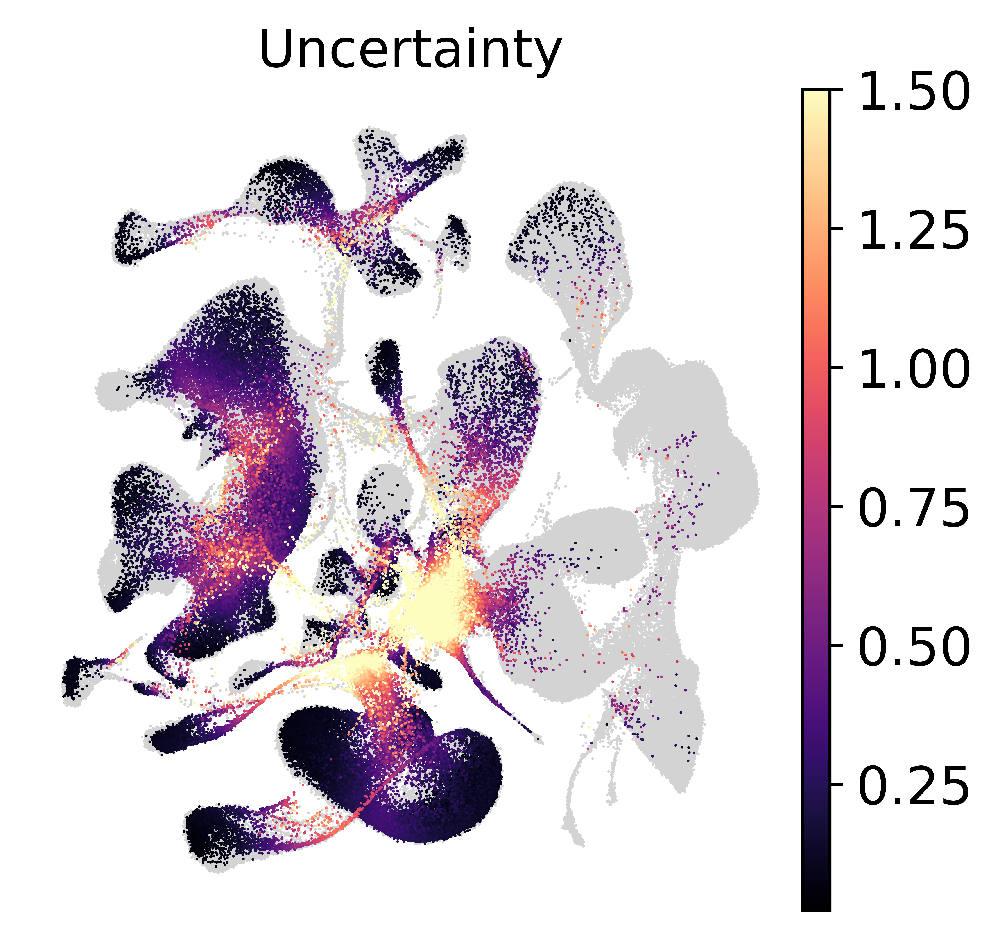

In [7]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_noland, color='log_probs', show=False, ax=ax, frameon=False, cmap='magma', vmax=1.5, size=2)
#sc.pl.umap(adata[adata.obs['query'].isin(['2'])], color='log_probs', ax=ax, size=100, edgecolor='black', show=False)
h, l = ax.get_legend_handles_labels()
#ax.legend(handles = h[:58], labels = l[:58], bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=9, ncol=2, frameon=False)
ax.set_title('Uncertainty')
fig.savefig('figure_hlca/cancer_uncertainty_umap.png', dpi=500, bbox_inches='tight')

<ipython-input-8-26eb7d05b437>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_noland.obs['outcome_unc'][adata_noland.obs['log_probs'] >thr] = 'Unknown'
/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


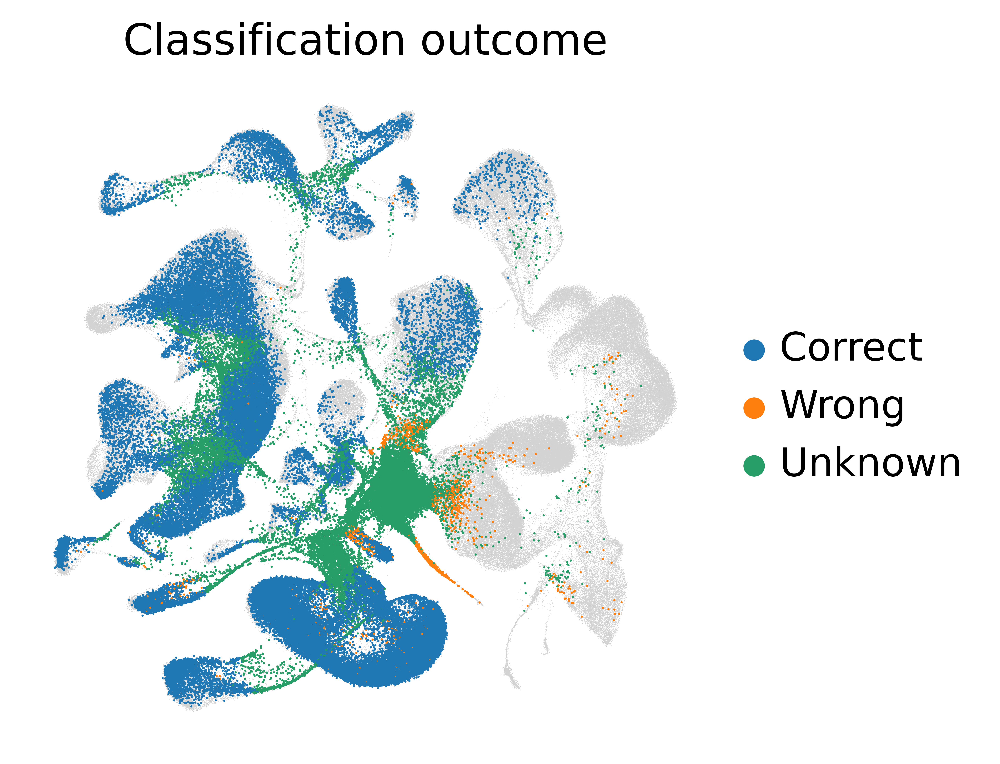

In [8]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
uncert = adata_noland.obs['log_probs'][~adata_noland.obs['log_probs'].isna()]
thr = uncert.quantile(.8)
adata_noland.obs['outcome_unc'] = adata_noland.obs['outcome'].astype(str)
adata_noland.obs['outcome_unc'][adata_noland.obs['log_probs'] >thr] = 'Unknown'
adata_noland.obs['unknown'] = (adata_noland.obs['log_probs'] > thr)
adata_noland.obs['outcome_plot'] = adata_noland.obs['outcome_unc'].map(
    {
        'False': 'Wrong',
        'True': 'Correct',
        'Unknown': 'Unknown'
    })
adata_noland.obs['outcome_plot'] = adata_noland.obs['outcome_plot'].astype('category')
adata_noland.obs['outcome_plot'] = adata_noland.obs['outcome_plot'].cat.reorder_categories(['Correct', 'Wrong', 'Unknown'])
sc.pl.umap(adata_noland, show=False, ax=ax, frameon=False,)
sc.pl.umap(adata_noland[adata_noland.obs['query'] == '1'], color='outcome_plot', show=False, ax=ax, frameon=False, size=2)
#sc.pl.umap(adata[adata.obs['query'].isin(['2'])], color='log_probs', ax=ax, size=100, edgecolor='black', show=False)
h, l = ax.get_legend_handles_labels()
#ax.legend(handles = h[:58], labels = l[:58], bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=9, ncol=2, frameon=False)
ax.set_title('Classification outcome')
fig.savefig('figure_hlca/cancer_outcome_umap.png', dpi=500, bbox_inches='tight')

In [9]:
listdict = []
adata_query = adata_noland[adata_noland.obs['query'] == '1']
for ct in adata_query.obs['ann_finest_level'].unique():
    acc = (
        np.sum(
            adata_query.obs[adata_query.obs['ann_finest_level'] == ct]['outcome'] == 'True'
        )
        / len(adata_query.obs[adata_query.obs['ann_finest_level'] == ct])
    )
    unkn = (
        np.sum(
            adata_query.obs[adata_query.obs['ann_finest_level'] == ct]['unknown'] == True
        )
        / len(adata_query.obs[adata_query.obs['ann_finest_level'] == ct])
    )
    l = len(adata_query.obs[adata_query.obs['ann_finest_level'] == ct])
    listdict.append({
        'ct': f'{ct} ({l})',
        'Correct': acc,
        'Unknown': unkn,
        'n_cells': len(adata_query.obs[adata_query.obs['ann_finest_level'] == ct]),
    })

acc = (
    np.sum(
        adata_query.obs['outcome'] == 'True'
    )
    / len(adata_query)
)
unkn = (
    np.sum(
        adata_query.obs['unknown'] == True
    )
    / len(adata_query.obs)
)
listdict.append({
    'ct': 'overall',
    'Correct': acc,
    'Unknown': unkn,
    'n_cells': len(adata_query),
})

df = pd.DataFrame(listdict).set_index('ct').sort_values(by='ct')
df['Wrong'] = 1 - df['Correct'] - df['Unknown']

df = df.reindex(['Alveolar epithelium (4052)',
 'B cell lineage (7314)',
 'Endothelial (3767)',
 'Epithelial (460)',
 'Fibroblast lineage (2455)',
 'Mast cells (1191)',
 'Myeloid (24028)',
 'T cell lineage (37601)',
 'Cancer (12312)',
 'Erythroblast (395)',
 'overall'])

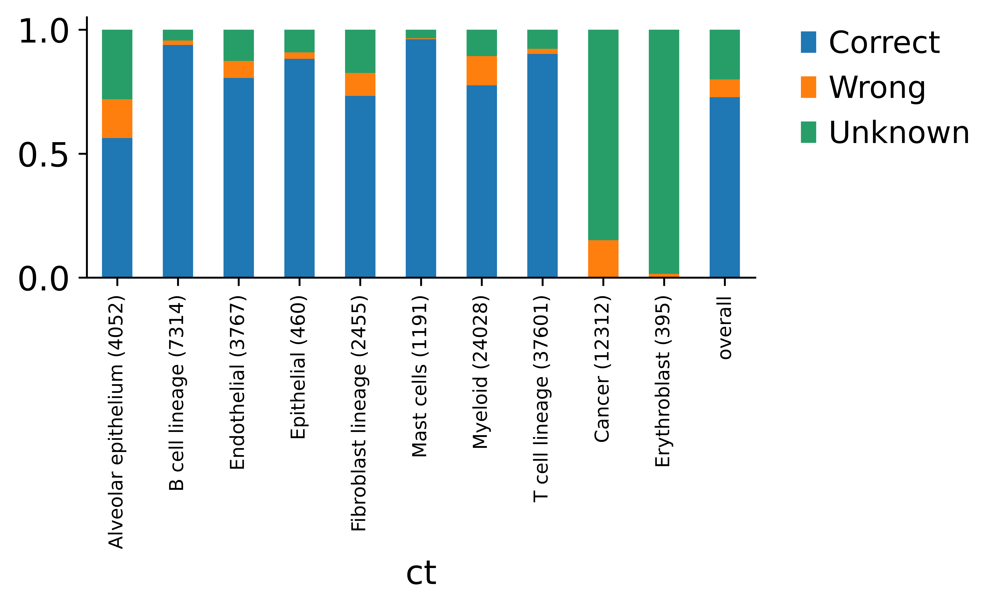

In [10]:
fig, ax = plt.subplots(1, 1, figsize=(5, 2))

df[['Correct', 'Wrong', 'Unknown']].plot(kind='bar', stacked=True, ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), fontsize=8)
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., frameon=False)
ax.grid(False)
sns.despine()
fig.savefig('figure_hlca/cancer_accuracy.png', dpi=500, bbox_inches='tight')

In [11]:
df

,Correct,Unknown,n_cells,Wrong
ct,,,,
Alveolar epithelium (4052),0.563179,0.280355,4052,0.156466
B cell lineage (7314),0.938474,0.043478,7314,0.018048
Endothelial (3767),0.805681,0.126095,3767,0.068224
Epithelial (460),0.882609,0.091304,460,0.026087
Fibroblast lineage (2455),0.733198,0.174338,2455,0.092464
Mast cells (1191),0.961377,0.034425,1191,0.004198
Myeloid (24028),0.775554,0.106085,24028,0.118362
T cell lineage (37601),0.902183,0.076780,37601,0.021037
Cancer (12312),0.000000,0.848765,12312,0.151235
